# バブルチャート

## 準備

### Import

In [1]:
# warningsモジュールのインポート
import warnings

# データ解析や機械学習のライブラリ使用時の警告を非表示にする目的で警告を無視
# 本書の文脈では、可視化の学習に議論を集中させるために選択した
# ただし、学習以外の場面で、警告を無視する設定は推奨しない
warnings.filterwarnings("ignore")

In [2]:
# itertoolsモジュールのインポート
# 様々なパターンのループを効率的に実行可能
import itertools

# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

### 変数

In [3]:
# マンガデータ保存ディレクトリのパス
DIR_CM = Path("../../../data/cm/input")
# アニメデータ保存ディレクトリのパス
DIR_AN = Path("../../../data/an/input")
# ゲームデータ保存ディレクトリのパス
DIR_GM = Path("../../../data/gm/input")

# マンガデータの分析結果の出力先ディレクトリのパス
DIR_OUT_CM = (
    DIR_CM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "bubble"
)
# アニメデータの分析結果の出力先ディレクトリのパス
DIR_OUT_AN = (
    DIR_AN.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "bubble"
)
# ゲームデータの分析結果の出力先ディレクトリのパス
DIR_OUT_GM = (
    DIR_GM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "bubble"
)

In [4]:
# 読み込み対象ファイル名の定義

# マンガ各話に関するファイル
FN_CE = "cm_ce.csv"

# マンガ作品と原作者の対応関係に関するファイル
FN_CC_CRT = "cm_cc_crt.csv"

# アニメ各話に関するファイル
FN_AE = "an_ae.csv"

# アニメ作品と声優の対応関係に関するファイル
FN_AC_ACT = "an_ac_act.csv"

# ゲームパッケージとプラットフォームの対応関係に関するファイル
FN_PKG_PF = "gm_pkg_pf.csv"

In [5]:
# 国内主要ゲームメーカーのプラットフォームとメーカー名の対応辞書
# キー: プラットフォーム名、値: メーカー名の略称
PF2MK = {
    "プレイステーション": "ソニー",
    "プレイステーション2": "ソニー",
    "プレイステーション・ポータブル": "ソニー",
    "プレイステーション3": "ソニー",
    "プレイステーションVita": "ソニー",
    "プレイステーション4": "ソニー",
    "ゲームアーカイブス": "ソニー",
    "SG-1000": "セガ",
    "SC-3000": "セガ",
    "SEGAマーク3": "セガ",
    "セガ・マスターシステム": "セガ",
    "メガドライブ": "セガ",
    "ゲームギア": "セガ",
    "セガサターン": "セガ",
    "ドリームキャスト": "セガ",
    "ファミリーコンピュータ": "任天堂",
    "ゲームボーイ": "任天堂",
    "スーパーファミコン": "任天堂",
    "NINTENDO64": "任天堂",
    "ゲームボーイアドバンス": "任天堂",
    "ニンテンドーゲームキューブ": "任天堂",
    "ニンテンドーDS": "任天堂",
    "ニンテンドー3DS": "任天堂",
    "Wii": "任天堂",
    "WiiU": "任天堂",
    "NintendoSwitch": "任天堂",
}

In [6]:
# pandasのweekday関数で取得できる曜日の数値と実際の曜日名を対応させる辞書を定義
# 0:月曜日, 1:火曜日, ... , 6:日曜日
WEEKDAY2YOBI = {
    0: "月",
    1: "火",
    2: "水",
    3: "木",
    4: "金",
    5: "土",
    6: "日",
}

In [7]:
# 質的変数の描画用のカラースケールの定義

# Okabe and Ito (2008)基準のカラーパレット
# 色の識別性が高く、多様な色覚の人々にも見やすい色組み合わせ
# 参考URL: https://jfly.uni-koeln.de/color/#pallet
OKABE_ITO = [
    "#000000",  # 黒 (Black)
    "#E69F00",  # 橙 (Orange)
    "#56B4E9",  # 薄青 (Sky Blue)
    "#009E73",  # 青緑 (Bluish Green)
    "#F0E442",  # 黄色 (Yellow)
    "#0072B2",  # 青 (Blue)
    "#D55E00",  # 赤紫 (Vermilion)
    "#CC79A7",  # 紫 (Reddish Purple)
]

In [8]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

### 関数

In [9]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

In [10]:
def add_jitter(values: pd.Series, scale: float = 0.3, seed: int = None) -> pd.Series:
    """
    与えられた値にジッタリング（ランダムなノイズ）を適用する

    Parameters
    ----------
    values : pd.Series
        ジッタリングを適用する数値が含まれるPandasのSeries
    scale : float, optional
        ランダムノイズの大きさを調整するためのスケール因子、デフォルトは0.3
    seed : int, optional
        乱数生成のためのシード値、指定された場合再現可能なランダムノイズが生成される

    Returns
    -------
    pd.Series
        ジッタリングが適用された数値を含むPandasのSeries
    """

    # シード値が指定された場合は、乱数ジェネレータを初期化
    if seed is not None:
        np.random.seed(seed)

    # ランダムなノイズを生成して値に加える
    return values + np.random.randn(len(values)) * scale

In [11]:
def save_df_to_csv(df: pd.DataFrame, dir_save: Path, fn_save: str) -> None:
    """
    DataFrameをCSVファイルとして指定されたディレクトリに保存する関数

    Parameters
    ----------
    df : pd.DataFrame
        保存対象となるDataFrame
    dir_save : Path
        出力先ディレクトリのパス
    fn_save : str
        保存するCSVファイルの名前（拡張子は含めない）
    """
    # 出力先ディレクトリが存在しない場合は作成
    dir_save.mkdir(parents=True, exist_ok=True)

    # 出力先のパスを作成
    p_save = dir_save / f"{fn_save}.csv"

    # DataFrameをCSVファイルとして保存する
    df.to_csv(p_save, index=False, encoding="utf-8-sig")

    # 保存完了のメッセージを表示する
    print(f"DataFrame is saved as '{p_save}'.")

## 可視化例

(bubble-cm)=
### マンガデータ

In [12]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ce = pd.read_csv(DIR_CM / FN_CE)
df_cc_crt = pd.read_csv(DIR_CM / FN_CC_CRT)

In [13]:
# 可視化のための集計
# 各マンガ作品（cc）に紐づく原作者（crt）の情報をマージ
df_cm = pd.merge(df_ce, df_cc_crt[["ccid", "crtid", "crtname"]], on="ccid", how="outer")

# 雑誌の各巻号（miname）ごとにデータを集計
df_cm = (
    df_cm.groupby(["miname"])[["ccid", "crtid", "page_end", "date", "price", "mcname"]]
    .agg(
        {
            "ccid": "nunique",  # 作品数：ユニークなccidの数
            "crtid": "nunique",  # 作者数：ユニークなcrtidの数
            "page_end": "max",  # 合計ページ数：page_endの最大値
            "date": "first",  # 発売日：dateの最初の値
            "price": "first",  # 価格：priceの最初の値
            "mcname": "first",  # 雑誌名：mcnameの最初の値
        }
    )
    .reset_index()
)

# カラム名をわかりやすく変更
df_cm = df_cm.rename(
    columns={
        "miname": "マンガ雑誌巻号名",
        "ccid": "マンガ作品数",
        "crtid": "マンガ作者数",
        "page_end": "合計ページ数",
        "date": "発売日",
        "price": "価格",
        "mcname": "マンガ雑誌名",
    }
)

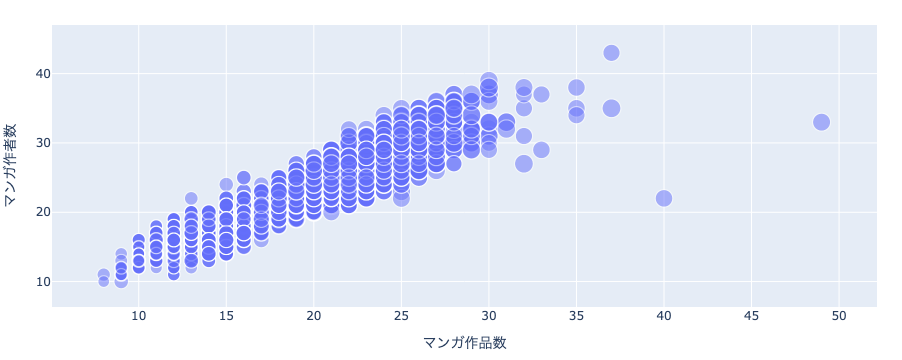

In [14]:
# px.scatter関数を使用してバブルチャートを作成
# x軸に作品数、y軸に作者数、凡例のサイズを合計ページ数でプロット
# 各点には雑誌巻号名、発売日、雑誌名をホバー情報として表示
fig = px.scatter(
    df_cm,
    x="マンガ作品数",
    y="マンガ作者数",
    size="合計ページ数",
    hover_name="マンガ雑誌巻号名",
    hover_data=["発売日", "マンガ雑誌名"],
)

# マーカーのスタイルを設定
# 線幅を1、透明度を0.5に設定
fig.update_traces(
    marker={
        "line_width": 1,
        "opacity": 0.5,
    }
)

# バブルチャートを表示
show_fig(fig)

In [15]:
# add_jitter関数でランダムなノイズ（scaleで標準偏差を指定可能）を追加
# seedをそれぞれ指定することで再現性を確保
df_cm["マンガ作品数（ジッタリング後）"] = add_jitter(
    df_cm["マンガ作品数"], scale=0.25, seed=0
)
df_cm["マンガ作者数（ジッタリング後）"] = add_jitter(
    df_cm["マンガ作者数"], scale=0.25, seed=1
)

In [16]:
# 発売日をdatetime型に変換し、dt.yearで発売年を抽出
df_cm["発売年"] = pd.to_datetime(df_cm["発売日"]).dt.year

In [17]:
# 可視化対象のDataFrameを確認
df_cm.head()

,マンガ雑誌巻号名,マンガ作品数,マンガ作者数,合計ページ数,発売日,価格,マンガ雑誌名,マンガ作品数（ジッタリング後）,マンガ作者数（ジッタリング後）,発売年
0,週刊少年サンデー 1970年 表示号数32,12,14,284.0,1970-08-02,80.0,週刊少年サンデー,12.441013,14.406086,1970
1,週刊少年サンデー 1970年 表示号数33,12,16,307.0,1970-08-09,90.0,週刊少年サンデー,12.100039,15.847061,1970
2,週刊少年サンデー 1970年 表示号数34,13,17,314.0,1970-08-16,90.0,週刊少年サンデー,13.244684,16.867957,1970
3,週刊少年サンデー 1970年 表示号数35,13,17,305.0,1970-08-23,90.0,週刊少年サンデー,13.560223,16.731758,1970
4,週刊少年サンデー 1970年 表示号数36,13,17,305.0,1970-08-30,90.0,週刊少年サンデー,13.466889,17.216352,1970


In [18]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_cm, DIR_OUT_CM, "cm")

DataFrame is saved as '../../../data/cm/output/vol2/04/bubble/cm.csv'.


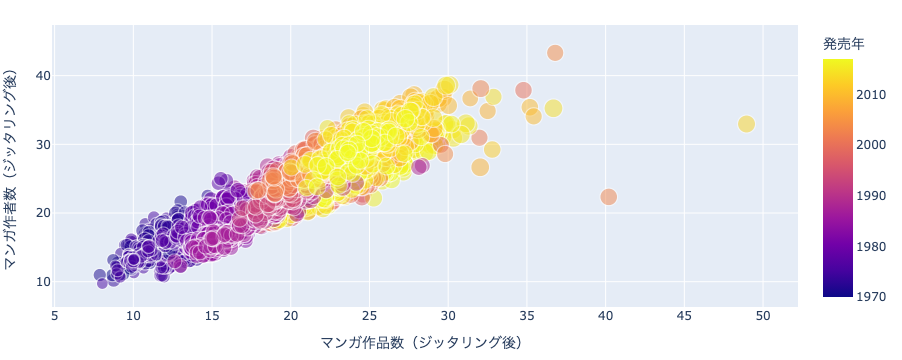

In [19]:
# px.scatter関数を使用してバブルチャートを作成
# x軸に作品数（ジッタリング後）、y軸に作者数（ジッタリング後）を指定
# 凡例のサイズに合計ページ数、凡例の色に発売年を指定
# 各点には雑誌巻号名、発売日、雑誌名をホバー情報として表示
fig = px.scatter(
    df_cm,
    x="マンガ作品数（ジッタリング後）",
    y="マンガ作者数（ジッタリング後）",
    size="合計ページ数",
    color="発売年",
    hover_name="マンガ雑誌巻号名",
    hover_data=["マンガ雑誌巻号名", "発売日", "マンガ雑誌名"],
)

# マーカーのスタイルを設定
# 線幅を1、透明度を0.5に設定
fig.update_traces(
    marker={
        "line_width": 1,
        "opacity": 0.5,
    }
)

# バブルチャートを表示
show_fig(fig)

In [20]:
# アニメーション作成用に、雑誌名・販売年別の作品数・作者数・合計ページ数の平均値を算出
df_cm2 = (
    df_cm.groupby(["マンガ雑誌名", "発売年"])[
        ["マンガ作品数", "マンガ作者数", "合計ページ数"]
    ]
    .mean()
    .reset_index()
)

In [21]:
# アニメーション作成時の描画領域の端点を指定
# 各最大値の1.1倍としたのは余白を持たせるため
x_max = df_cm2["マンガ作品数"].max() * 1.1
y_max = df_cm2["マンガ作者数"].max() * 1.1

In [22]:
# 可視化対象のDataFrameを確認
df_cm2.head()

,マンガ雑誌名,発売年,マンガ作品数,マンガ作者数,合計ページ数
0,週刊少年サンデー,1970,12.333333,16.428571,284.190476
1,週刊少年サンデー,1971,12.411765,16.490196,281.666667
2,週刊少年サンデー,1972,12.647059,15.803922,291.862745
3,週刊少年サンデー,1973,13.098039,16.098039,302.549020
4,週刊少年サンデー,1974,11.020000,15.860000,248.280000


In [23]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_cm2, DIR_OUT_CM, "cm2")

DataFrame is saved as '../../../data/cm/output/vol2/04/bubble/cm2.csv'.


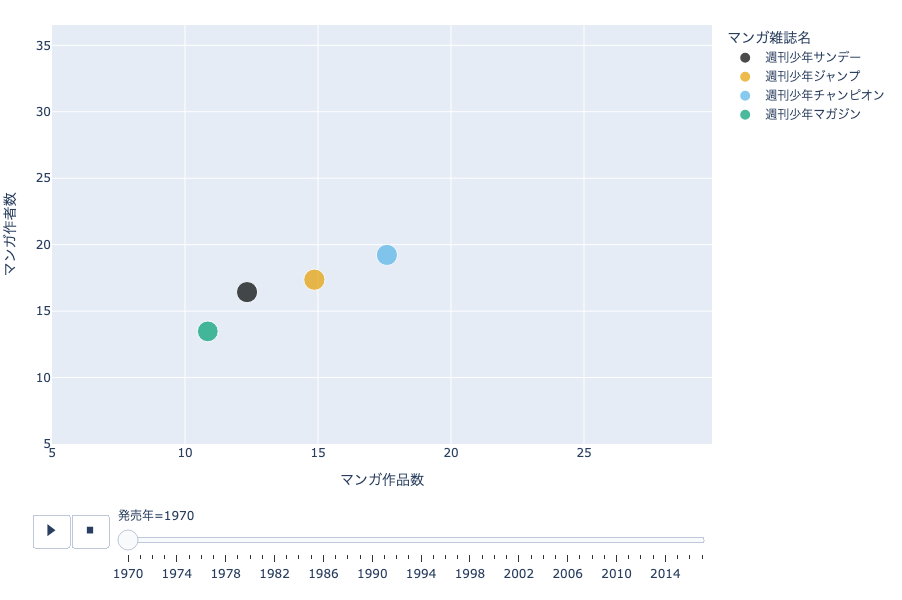

In [24]:
# px.scatter関数を使用してバブルチャートを作成
# x軸に作品数、y軸に作者数を指定
# 凡例のサイズに合計ページ数、凡例の色に雑誌名を指定
# 発売年ごとの雑誌名別のマーカーが動くようanimation_*を指定
# x軸とy軸の表示領域を指定
# カラーテーマとしてOKABE_ITOを指定
fig = px.scatter(
    df_cm2,
    x="マンガ作品数",
    y="マンガ作者数",
    size="合計ページ数",
    color="マンガ雑誌名",
    animation_frame="発売年",
    animation_group="マンガ雑誌名",
    range_x=[5, x_max],
    range_y=[5, y_max],
    color_discrete_sequence=OKABE_ITO,
    height=600,
)

# モーションチャートを表示
show_fig(fig)

(bubble-an)=
### アニメデータ

In [25]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ae = pd.read_csv(DIR_AN / FN_AE)
df_ac_act = pd.read_csv(DIR_AN / FN_AC_ACT)

In [26]:
# 可視化のための集計
# アニメ作品ごとの統計情報を集計して可視化用のデータフレームを作成

# 'acid'（アニメ作品ID）と'acname'（アニメ作品名）を基準にグルーピング
# 各アニメ作品ごとに'aeid'（各話ID）のユニーク数（各話数）と'date'（放送日）のユニーク数（放送日数）を計算
df_an = df_ae.groupby(["acid", "acname"])[["aeid", "date"]].nunique().reset_index()

# アニメ作品ごとに声優のユニーク数（声優数）を集計
# 'acid'（アニメ作品ID）を基準にグルーピングし、'actid'（声優ID）のユニーク数を計算
# その結果を辞書として保存し、アニメ作品IDをキーとして声優数を取得
acid2n_act = df_ac_act.groupby("acid")["actid"].nunique().to_dict()
df_an["n_act"] = df_an["acid"].apply(lambda x: acid2n_act.get(x, None))

# カラム名を変更して、結果をわかりやすくする
df_an = df_an.rename(
    columns={
        "acname": "アニメ作品名",
        "aeid": "アニメ各話数",
        "date": "放送日数",
        "n_act": "声優数",
    }
)

In [27]:
# 声優数がNaNの行を削除
df_an = df_an.dropna(subset=["声優数"], ignore_index=True)

In [28]:
# 可視化対象のDataFrameを確認
df_an.head()

,acid,アニメ作品名,アニメ各話数,放送日数,声優数
0,C10001,ギャラクシー エンジェル,24,23,9.0
1,C10003,PROJECT ARMS,26,26,11.0
2,C10005,探偵少年カゲマン,6,5,12.0
3,C10008,GEAR戦士[ギアファイター] 電童,38,38,10.0
4,C10010,グラビテーション,13,13,9.0


In [29]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an, DIR_OUT_AN, "an")

DataFrame is saved as '../../../data/an/output/vol2/04/bubble/an.csv'.


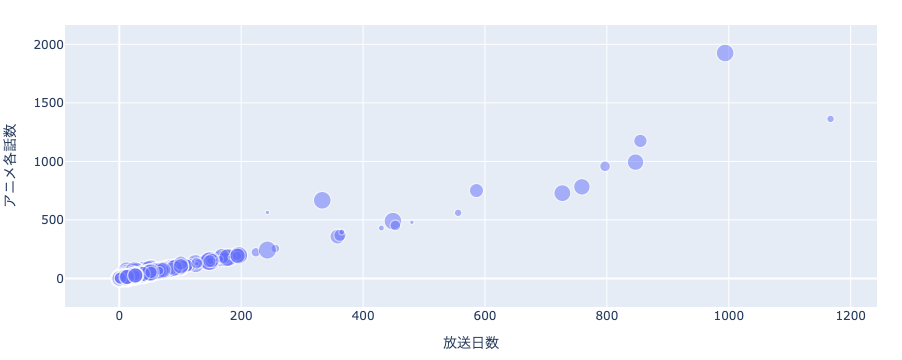

In [30]:
# アニメ作品の放送日数と各話数の関係をバブルチャートで可視化
# '放送日数'をx軸に、'各話数'をy軸に取り、'声優数'をバブルの大きさで表現
# 'hover_name'引数に'アニメ作品名'を指定して、マウスホバー時にアニメ作品名を表示
fig = px.scatter(
    df_an,
    x="放送日数",
    y="アニメ各話数",
    size="声優数",
    hover_name="アニメ作品名",
)

# マーカーのスタイルを設定
# 'line_width'で境界線の幅を1に設定
# 'opacity'でマーカーの透明度を0.5に設定
fig.update_traces(
    marker={
        "line_width": 1,
        "opacity": 0.5,
    }
)

# バブルチャートを表示
show_fig(fig)

In [31]:
# dateをdatetime型に変換し、dt.weekdayで曜日情報を取得
df_ae["weekday"] = pd.to_datetime(df_ae["date"]).dt.weekday

# acid2weekday={acid:weekday}を作成
# acid, weekdayごとにユニークなaeid数(n_ae)を集計
# 最もn_aeが多いweekdayをacidごとに抽出し、辞書化
acid2weekday = (
    df_ae.groupby(["acid", "weekday"])["aeid"]
    .nunique()
    .reset_index(name="n_ae")
    .sort_values(["acid", "n_ae"], ascending=[True, False])
    .drop_duplicates("acid")
    .set_index("acid")["weekday"]
    .to_dict()
)

In [32]:
# 新たなDataFrameを作成
df_an2 = df_an.copy()

# acid2weekdayを用いたマッピング結果をdf_anにweekday列として追加
df_an2["weekday"] = df_an2["acid"].map(acid2weekday)
# WEEKDAY2YOBIを用いて曜日文字列にマッピングし、放送曜日列として追加
df_an2["放送曜日"] = df_an2["weekday"].map(WEEKDAY2YOBI)
# 可視化した際に曜日順になるように、事前にdf_anをweekdayで昇順ソート
df_an2 = df_an2.sort_values("weekday", ignore_index=True)

In [33]:
# 可視化対象のDataFrameを確認
df_an2.head()

,acid,アニメ作品名,アニメ各話数,放送日数,声優数,weekday,放送曜日
0,C12321,よみがえる空 ──RESCUE WINGS,13,12,9.0,0,月
1,C10955,B-伝説［ビーレジェンド］! バトルビーダマン炎魂［ファイヤースピリッツ］!,51,51,15.0,0,月
2,C13037,闘牌伝説 アカギ 闇に舞い降りた天才 特別編,4,1,9.0,0,月
3,C13042,かくざ父さん,11,11,1.0,0,月
4,C13044,アームズラリー,11,11,5.0,0,月


In [34]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an2, DIR_OUT_AN, "an2")

DataFrame is saved as '../../../data/an/output/vol2/04/bubble/an2.csv'.


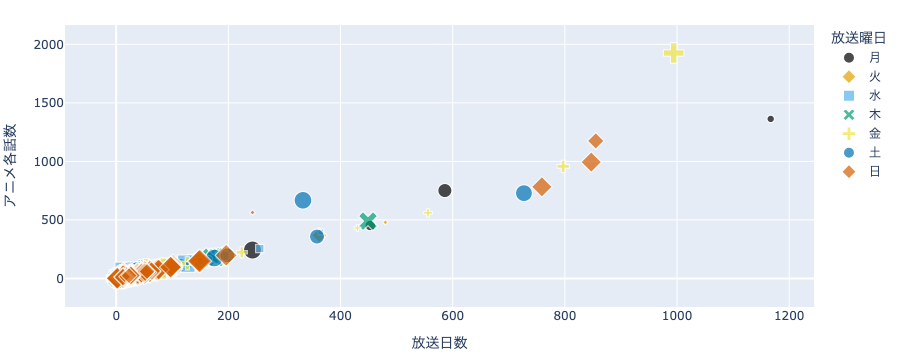

In [35]:
# アニメ作品の放送日数と各話数の関係をバブルチャートで可視化
# '放送日数'をx軸に、'各話数'をy軸に取り、'声優数'をバブルの大きさで表現
# '放送曜日'でマーカーのシンボルと色を変更、配色にはOKABE_ITOテーマを利用
# 'hover_name'引数に'アニメ作品名'を指定して、マウスホバー時にアニメ作品名を表示
fig = px.scatter(
    df_an2,
    x="放送日数",
    y="アニメ各話数",
    size="声優数",
    color="放送曜日",
    symbol="放送曜日",
    hover_name="アニメ作品名",
    color_discrete_sequence=OKABE_ITO,
)

# マーカーのスタイルを設定
# 'line_width'で境界線の幅を1に設定
# 'opacity'でマーカーの透明度を0.5に設定し、重複が多い部分の視認性を向上
fig.update_traces(
    marker={
        "line_width": 1,
        "opacity": 0.7,
    }
)

# バブルチャートを表示
show_fig(fig)

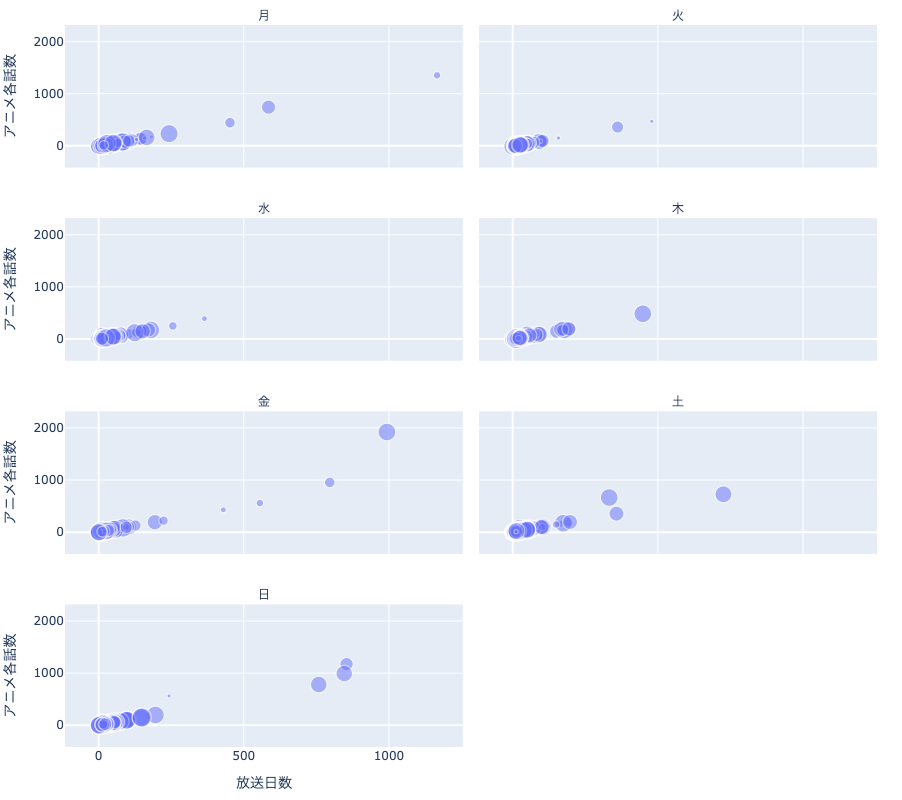

In [36]:
# アニメ作品の放送日数と各話数の関係をバブルチャートで可視化
# '放送日数'をx軸に、'各話数'をy軸に取り、'声優数'をバブルの大きさで表現
# '放送曜日'でファセットを分け、ファセットは最大2列で表示
# 'hover_name'引数に'アニメ作品名'を指定して、マウスホバー時にアニメ作品名を表示
# 複数のファセットを表示するため高さを調整
fig = px.scatter(
    df_an2,
    x="放送日数",
    y="アニメ各話数",
    size="声優数",
    facet_col="放送曜日",
    facet_col_wrap=2,
    hover_name="アニメ作品名",
    height=800,
)

# マーカーのスタイルを設定
# 'line_width'で境界線の幅を1に設定
# 'opacity'でマーカーの透明度を0.5に設定し、重複が多い部分の視認性を向上
fig.update_traces(
    marker={
        "line_width": 1,
        "opacity": 0.5,
    }
)

# ファセット（放送曜日ごとのバブルチャート）のタイトルを簡潔にする処理
# デフォルトではタイトルは「放送曜日=xxx」という形式になっている
# この処理は「=」で文字列を分割して「xxx」の部分だけを取り出す
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# バブルチャートを表示
show_fig(fig)

(bubble-gm)=
### ゲームデータ

In [37]:
# pandasのread_csv関数でCSVファイルの読み込み
df_pkg_pf = pd.read_csv(DIR_GM / FN_PKG_PF)

In [38]:
# 可視化のための集計
# プラットフォームごとのパッケージ数、パブリッシャー数、平均価格を算出

# 'pfname'（プラットフォーム名）ごとに'pkgid'（パッケージID）、'publisher'（パブリッシャー）、
# そして'price'（価格）を集計
# 'pkgid'はユニークな値の数（パッケージ数）、'publisher'はユニークな値の数（パブリッシャー数）を計算
# 'price'は平均価格を計算
df_gm = (
    df_pkg_pf.groupby("pfname")[["pkgid", "publisher", "price"]]
    .agg({"pkgid": "nunique", "publisher": "nunique", "price": "mean"})
    .reset_index()
)

# カラム名をわかりやすい名前に変更
df_gm = df_gm.rename(
    columns={
        "pfname": "プラットフォーム名",
        "pkgid": "ゲームパッケージ数",
        "publisher": "パブリッシャー数",
        "price": "平均価格",
    }
)

# 平均価格がNaNの行を削除
df_gm = df_gm.dropna(subset=["平均価格"], ignore_index=True)

In [39]:
# 可視化対象のDataFrameを確認
df_gm.head()

,プラットフォーム名,ゲームパッケージ数,パブリッシャー数,平均価格
0,3DO,115,68,8261.913043
1,ClassicMacOS,13,3,615.384615
2,MSX,1,1,5800.000000
3,MSX2,4,4,8800.000000
4,MicrosoftWindows,582,225,5676.073043


In [40]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm, DIR_OUT_GM, "gm")

DataFrame is saved as '../../../data/gm/output/vol2/04/bubble/gm.csv'.


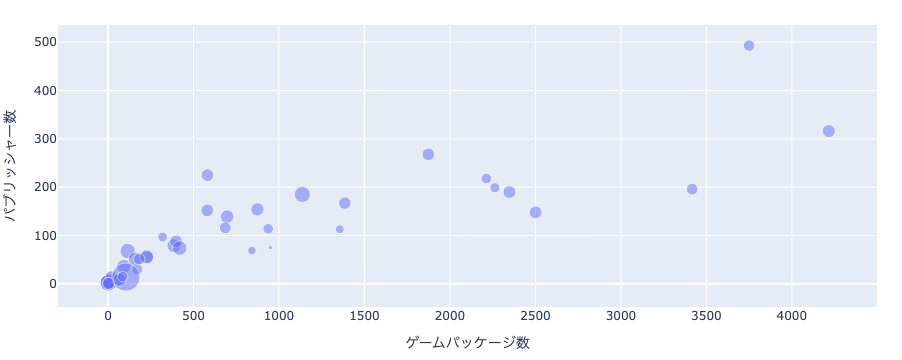

In [41]:
# プラットフォームごとのパッケージ数とパブリッシャー数の関係をバブルチャートで可視化
# x軸に'パッケージ数'、y軸に'パブリッシャー数'、バブルのサイズを'平均価格'を指定
# 各点はプラットフォームを表し、ホバーすると'プラットフォーム名'が表示される
fig = px.scatter(
    df_gm,
    x="ゲームパッケージ数",
    y="パブリッシャー数",
    size="平均価格",
    hover_name="プラットフォーム名",
)

# バブルチャートのマーカーのスタイルを設定
# 線の幅は1、透明度は0.5（重複が多いため）
fig.update_traces(
    marker={
        "line_width": 1,
        "opacity": 0.5,
    }
)

# バブルチャートを表示
show_fig(fig)